## Singular Value Decomposition

In [1]:
import numpy as np
from scipy.linalg import norm 
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
from sklearn.datasets import make_swiss_roll
matplotlib.style.use('seaborn-white')
from sklearn.datasets import load_sample_images
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns
from numpy import linalg

In [853]:
imgs = load_sample_images().images
china, flower = imgs[0], imgs[1]
china_swap = np.moveaxis(china, -1, 0)
flower_swap = np.moveaxis(flower, -1, 0)
print(flower.shape)
print(flower_swap.shape)

(427, 640, 3)
(3, 427, 640)


(-0.5, 639.5, 426.5, -0.5)

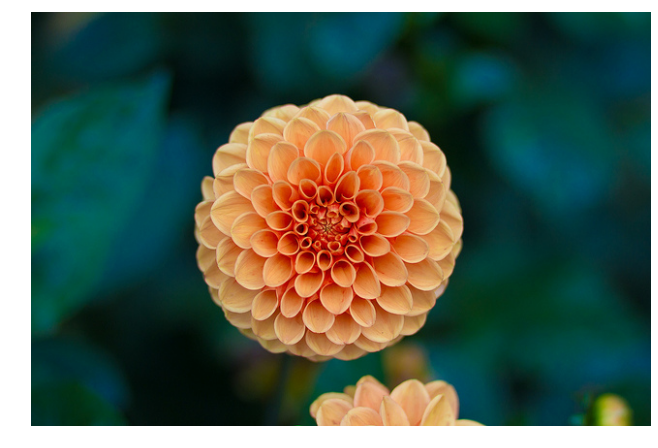

In [854]:
fig = plt.figure(figsize=(10,10))
plt.imshow(flower)
plt.axis('off')

(-0.5, 639.5, 426.5, -0.5)

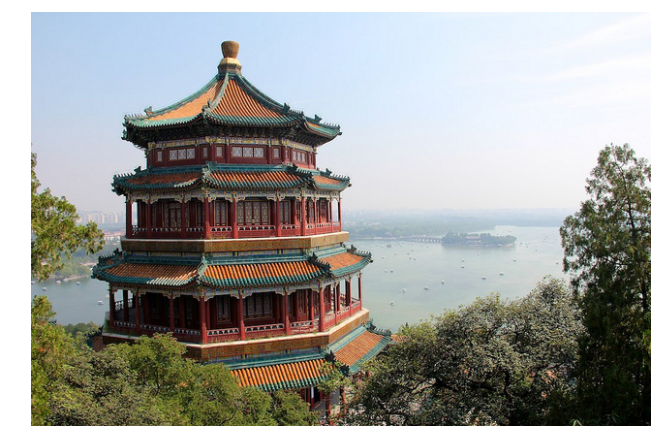

In [855]:
fig = plt.figure(figsize=(10,10))
plt.imshow(china)
plt.axis('off')

In [931]:
# Vectorize forbenius norm
frobenius_norm_vect = np.vectorize(linalg.norm, signature='(n,m)->()')

def low_rank_approximation(a, svd, rank, start_vect=1):
    """Compute a low rank approximation for a given n-dimensional matrix
    of dimension (..., n, m).
    
    Parameters: 
        a -- original n-dimensional matrix
        svd -- tuple of (u, s, vh)
        rank -- rank of resulting approximation matrix, value 
            of -1 means 'use all eigenvectors after the start'
        start_vect -- start of eigenvector range to use for 
            approximation
    """
    n, m = a.shape[-2:]
    min_dim = min(n,m)
    if rank == -1:
        rank = min_dim - start_vect + 1
    end_vect = start_vect + rank - 1
    ev_slice = slice(start_vect - 1, end_vect)
    assert rank <= min_dim
    assert start_vect > 0, 'Starting vector is 1-indexed!'
    assert end_vect <= min_dim, 'Eigenvector range out of bounds!'
    
    u, s, vh = svd
    u_approx = u[:, :, ev_slice]
    s_slice = s[:, ev_slice]
    s_approx = np.apply_along_axis(np.diag, arr=s_slice, axis=1)
    vh_approx = vh[:, ev_slice, :]
#     print(f'Left singular matrix size  : {u_approx.shape}')
#     print(f'Singular value matrix size : {s_approx.shape}')
#     print(f'Right singular matrix size : {vh_approx.shape}')
    
    full_fro_norm   = np.sqrt(np.sum(np.square(s),axis=1))
    approx_fro_norm = np.sqrt(np.sum(np.square(s_slice),axis=1))
#     print(f'Frobenius norm of original matrix: {full_fro_norm.round(2)}')
#     print(f'Frobenius norm of low rank matrix: {approx_fro_norm.round(2)}')
#     print(f'Frobenius norm ratio: {(approx_fro_norm / full_fro_norm).round(3)}')
    
    low_rank_matrix = (u_approx @ s_approx @ vh_approx)
    return low_rank_matrix
    
low_rank_approximation(
    a, 
    linalg.svd(a, full_matrices=False), 
    rank=1, 
    start_vect=1
);

In [925]:
def minmax(arr):
    minval = arr.min()
    maxval = arr.max()
    return (arr - minval)/(maxval - minval)

scale_vect = np.vectorize(minmax, signature='(n,m)->(n,m)')

In [929]:
(255*scale_vect(a)).astype(int)

array([[[  0,  51, 102],
        [153, 204, 255]],

       [[ 19,   0,  27],
        [  0,  53, 255]],

       [[  0,  51, 102],
        [153, 204, 255]],

       [[ 19,   0,  27],
        [  0,  53, 255]]])

(-0.5, 639.5, 426.5, -0.5)

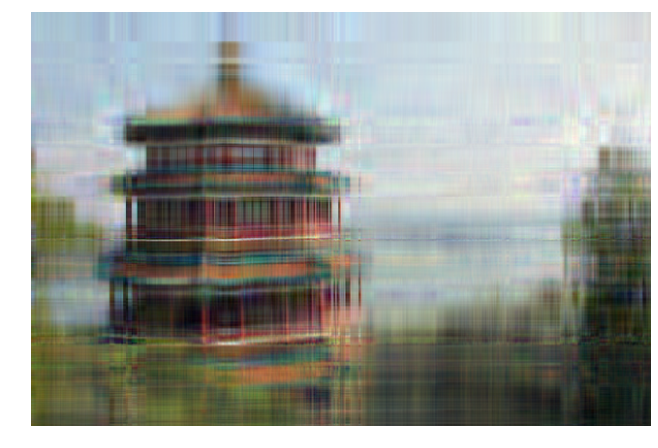

In [935]:
# View low rank approximation
china_approx_swap = low_rank_approximation(
    china_swap, 
    linalg.svd(china_swap, full_matrices=False), 
    rank = 10, 
    start_vect = 1
);
fig = plt.figure(figsize=(10,10))
china_scaled = (255*scale_vect(china_approx_swap)).astype(int)
china_approx = np.moveaxis(china_scaled, 0, -1)

plt.imshow(china_approx)
plt.axis('off')

In [933]:
china_approx.shape

(427, 640, 3)

Left singular matrix size  : (3, 427, 50)
Singular value matrix size : (3, 50, 50)
Right singular matrix size : (3, 50, 640)
Frobenius norm of original matrix: [54737.03 45227.39 34490.12]
Frobenius norm of low rank matrix: [54671.38 45099.76 34356.92]
Frobenius norm ratio: [0.999 0.997 0.996]


(-0.5, 639.5, 426.5, -0.5)

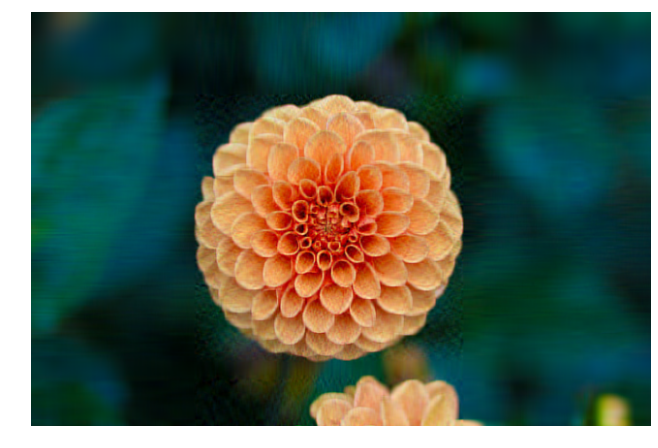

In [875]:
flower_approx_swap = low_rank_approximation(
    flower_swap, 
    linalg.svd(flower_swap, full_matrices=False),                               
    rank=50, 
    start_vect=1
);
fig = plt.figure(figsize=(10,10))
flower_approx = np.moveaxis(flower_approx_swap, 0, -1)
plt.imshow(flower_approx.astype(int))
plt.axis('off')

In [557]:
a = np.array([[[1,2,3],
              [4,5,6]],
             [[2,-8,6],
              [-8,19,120]],
            [[1,2,3],
              [4,5,6]],
             [[2,-8,6],
              [-8,19,120]]])

In [ ]:
china_approx_swap = low_rank_approximation(
    china_swap, 
    linalg.svd(china_swap, full_matrices=False), 
    rank = 100, 
    start_vect = 1
);
fig = plt.figure(figsize=(10,10))
china_approx = np.moveaxis(china_approx_swap, 0, -1)
plt.imshow(china_approx.astype(int))
plt.axis('off')

In [879]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [912]:
400 ** (1/20)

1.3492828476735634

In [919]:
from sklearn.preprocessing import MinMaxScaler

In [918]:
plt.rcParams["animation.embed_limit"] = 50.0

[1, 1, 2, 2, 3, 4, 6, 8, 10, 14, 18, 24, 31, 40, 53, 69, 90, 117, 153, 200, 153, 117, 90, 69, 53, 40, 31, 24, 18, 14, 10, 8, 6, 4, 3, 2, 2, 1]


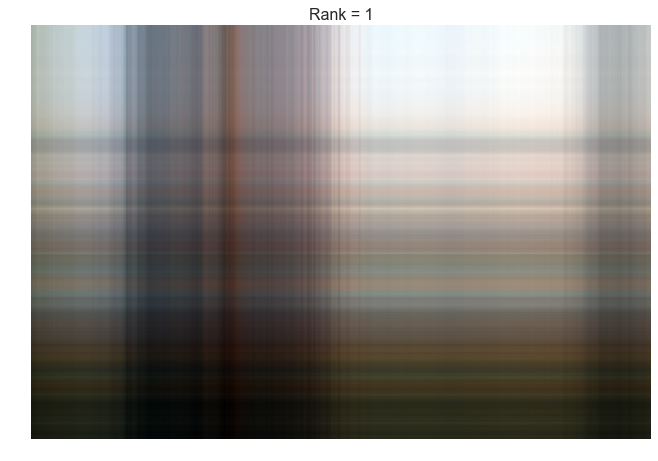

In [936]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
num_frames = 20
factor = 200 ** (1/num_frames)
rank_list = [int(factor ** x) for x in np.arange(1,num_frames+1)]
rank_list += rank_list[1:-1][::-1]
print(rank_list)
svd = linalg.svd(china_swap, full_matrices=False)

def animate(i):
    rank = rank_list[i]
    china_approx_swap = low_rank_approximation(
        china_swap, 
        svd, 
        rank = rank, 
        start_vect = 1
    );
    china_scaled = (255*scale_vect(china_approx_swap)).astype(int)
    china_approx = np.moveaxis(china_scaled, 0, -1)
    ax.imshow(china_approx.astype(int))
    ax.axis('off')
    ax.set_title(f'Rank = {rank}')
    
anim = FuncAnimation(
    fig, animate, 
    interval=100, 
    frames=len(rank_list)
);

HTML(anim.to_jshtml())

[1, 1, 2, 2, 3, 4, 6, 8, 10, 14, 18, 24, 31, 40, 53, 69, 90, 117, 153, 200]


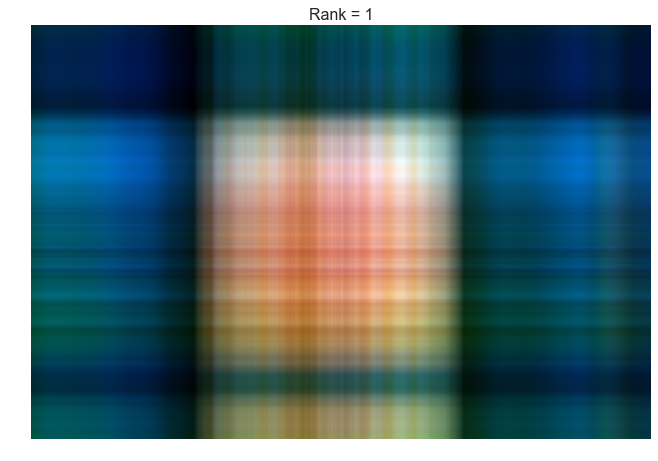

In [938]:
fig, ax = plt.subplots(1, 1, figsize=(10,10))
num_frames = 20
factor = 200 ** (1/num_frames)
rank_list = [int(factor ** x) for x in np.arange(1,num_frames+1)]
print(rank_list)
svd = linalg.svd(flower_swap, full_matrices=False)

def animate(i):
    rank = rank_list[i]
    flower_approx_swap = low_rank_approximation(
        flower_swap, 
        svd, 
        rank = rank, 
        start_vect = 1
    );
    flower_scaled = (255*scale_vect(flower_approx_swap)).astype(int)
    flower_approx = np.moveaxis(flower_scaled, 0, -1)
    ax.imshow(flower_approx.astype(int))
    ax.axis('off')
    ax.set_title(f'Rank = {rank}')
    
anim = FuncAnimation(
    fig, animate, 
    interval=100, 
    frames=len(rank_list)
);

HTML(anim.to_jshtml())